# Lab 1.3 Analysis
** Jason Chou **
<br>
- Goal: Make an HR diagram from G and B colors
- Todo: Measure net flux and generate catalog for each cluster: M3 (globular) and M67 (open)

In [123]:
%%capture
%load_ext autoreload
%autoreload 2

import sys
sys.path.append("/afs/ir.stanford.edu/class/physics100/workdir/g2/Jason/codes/")

import sextractor
import pyfits
import numpy as np
import matplotlib.pyplot as plt
import photometry as pho
from clusterHRdiag import *
from util import *
from matplotlib.colors import LogNorm
% matplotlib inline

## Prelude 
Calibrations were first done by Chun-Hao (04/21) for M3 and Jason for M67 (04/23). Since everybody in the group had run the calibration, I'm not sure what is the current version now. But the original ones are stored and run in Chun-Hao's directory: `/afs/ir.stanford.edu/class/physics100/workdir/g2/chto/Lab1.2_M3/` <br>
and Jason's notebook: <br>
`/afs/ir.stanford.edu/class/physics100/workdir/g2/Jason/Lab1.3/calibration.ipynb`

---
## M3
M3, the globular, crowded cluster. We must be careful about blending and stuff like that

In [93]:
## M3
M3_datadir = '/afs/ir.stanford.edu/class/physics100/workdir/g2/M3/'
predir  = '/afs/ir.stanford.edu/class/physics100/workdir/g2/'

M3_name = M3_datadir+"2017-04-13_24in/{0}/coadd/coadd.fits"
M3_workdir = predir+"Jason/Lab1.3/"
M3_basename = 'M3'

In [94]:
M3_HR = clusterHRdiag(M3_workdir,M3_name,M3_basename)

### SExtractor
Run the script and inspect the source selection

In [77]:
## try to account for very bright sources with large `maxarea`...
M3_HR.runSE(detect_thresh=3,
            detect_minarea=4,
            detect_maxarea=80,
            deblend_nthresh=64,
            deblend_mincont=0.00001,
            back_size=100)

The median of FWHM of the cataloged sources is 2.497 pixels


#### Flags

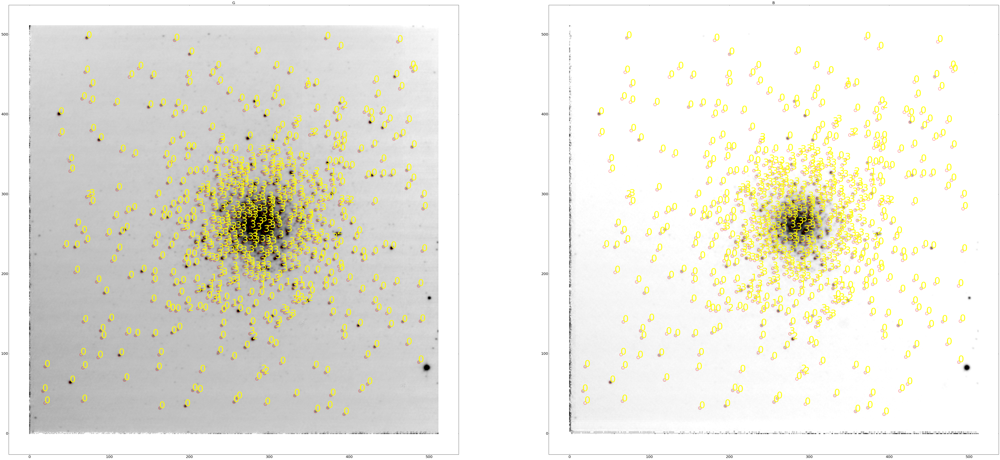

_(Double click to zoom in the plots)_

Still, not all stars are selected. As we tried, it is almost impossible. I'll leave it as it be.

We can see that sources with too high a flag are essentially "edge" artefacts while the central "blending" region has generally flags > 3. According to the documentation, only sources flagged with "0" should be kept:

#### SExtractor flags:

1     The object has neighbors, bright and close enough to 
      significantly bias the photometry, or bad pixels 
      (more than 10% of the integrated area affected).

2     The object was originally blended with another one.

4     At least one pixel of the object is saturated 
      (or very close to).

8     The object is truncates (to close to an image boundary).

16    Object's aperture data are incomplete or corrupted.

32    Object's isophotal data are incomplete or corrupted.

64    A memory overflow occurred during deblending.

128   A memory overflow occurred during extraction.

#### Remove the blendings

In [95]:
M3_HR.runSE(flagthr=1,
            detect_thresh=3,
            detect_minarea=4,
            detect_maxarea=80,
            deblend_nthresh=64,
            deblend_mincont=0.00001,
            back_size=100)

The median of FWHM of the cataloged sources is 2.196 pixels


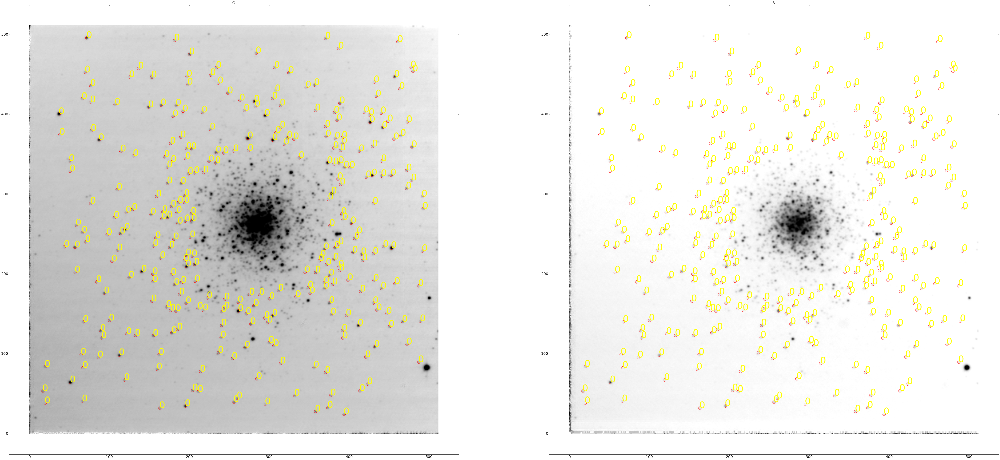

In [80]:
M3_HR.dispCatalog(low=3e2,high=15e2)

Despite loosing a lot of potential sources, it is better to have "quality" rather than "quantity", IMO

### HR diagram
Now, counting the fluxes can be tricky. Determining the aperture sizes is the first step:<br>
_The dashed circles show the background apeture, while the solid ones are for sources_

Nan fluxes: [X, Y, FWHM]
 []
Zero fluxes: [X, Y, FWHM]
 []
Negative fluxes: [X, Y, FWHM]
 []


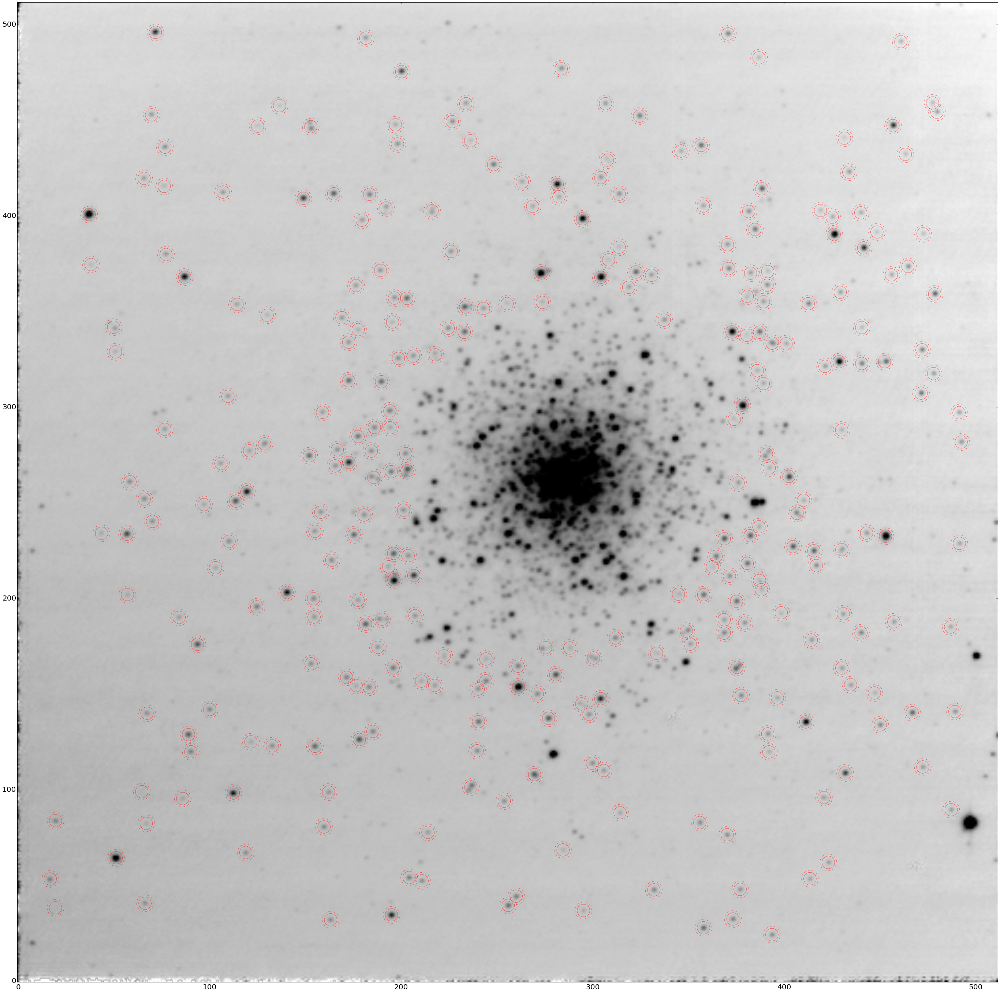

In [96]:
M3_HR.fluxArray()

_(Again, double click to zoom in for better viewing)_

Nice! For one thing, all the "net" fluxes are well-behaved (the `nan`, `zero`, `negative` lists are all empty). Moreover, we see that no "background" is enclosing other sources (or other spots). So the flux should be reliable

#### Color-Magnitude diagram

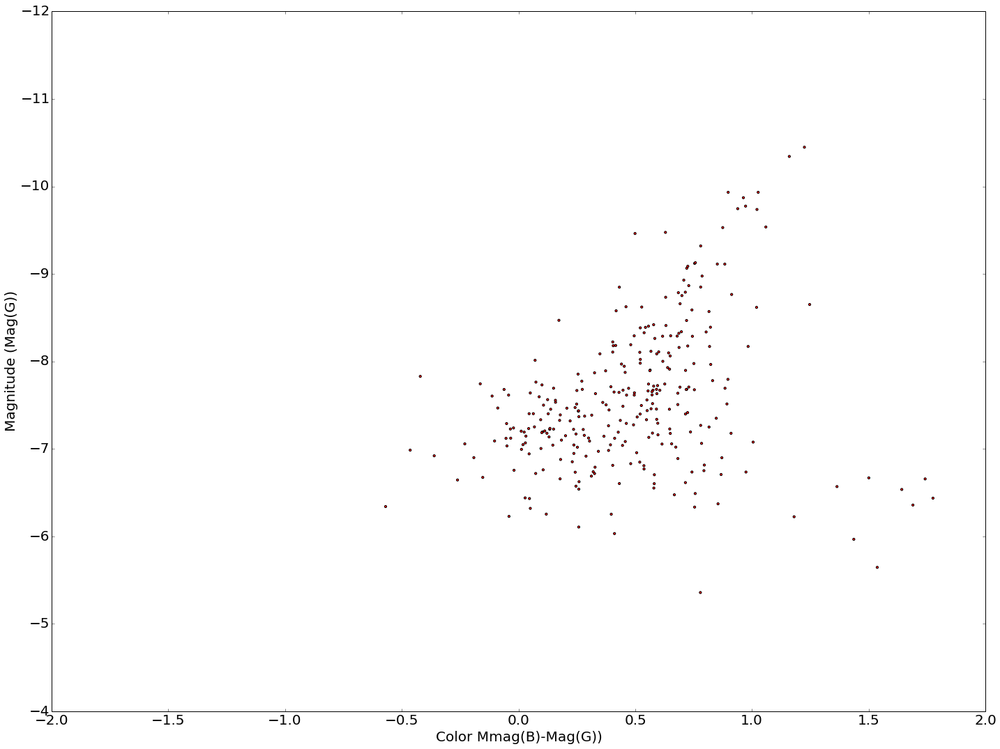

In [97]:
M3_HR.dispHR()

Although the magnitude is defined relative to an arbitrary reference, the x-axis should roughly correspond to the TRUE B-V values (yes, bearing in mind that subtraction of `log`s is division. So there could still be some offset...)

<img src='http://spiff.rit.edu/classes/phys230/lectures/hr/hip_vabs_chart.gif'>

By eye, it seems like we are observing the giants and a little bit of the main sequence! And if this is really the case, there is indeed an offset in the x-axis too. But we'll figure out later

---
## M67
Now the easier one... Everything should be simple

In [124]:
## M67
M67_datadir = '/afs/ir.stanford.edu/class/physics100/workdir/g2/M67/'
predir  = '/afs/ir.stanford.edu/class/physics100/workdir/g2/'

M67_name = M67_datadir+"2017-04-13/{0}/coadd/coadd.fits"
M67_workdir = predir+"Jason/Lab1.3/"
M67_basename = 'M67'

In [125]:
M67_HR = clusterHRdiag(M67_workdir,M67_name,M67_basename)

### SExtractor
Run the script and inspect the source selection

In [126]:
## here parameter choice shouldn't matter as much 
M67_HR.runSE(edge=50,flagthr=1,
             detect_thresh=3,
             detect_minarea=4,
             detect_maxarea=50,
             deblend_nthresh=64,
             deblend_mincont=0.00001,
             back_size=200)

The median of FWHM of the cataloged sources is 4.486 pixels


Well, the seeing was worse.

#### Flags

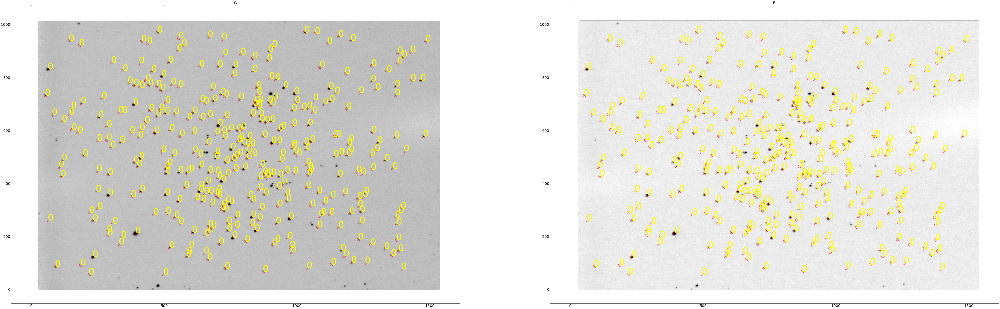

In [128]:
M67_HR.dispCatalog(low=20,high=500)

Hmmm, always missing some apparent sources. Otherwise good to go

### Checking the fluxes and apetures

invalid value encountered in greater
Nan fluxes: [X, Y, FWHM]
 []
Zero fluxes: [X, Y, FWHM]
 []
Negative fluxes: [X, Y, FWHM]
 []


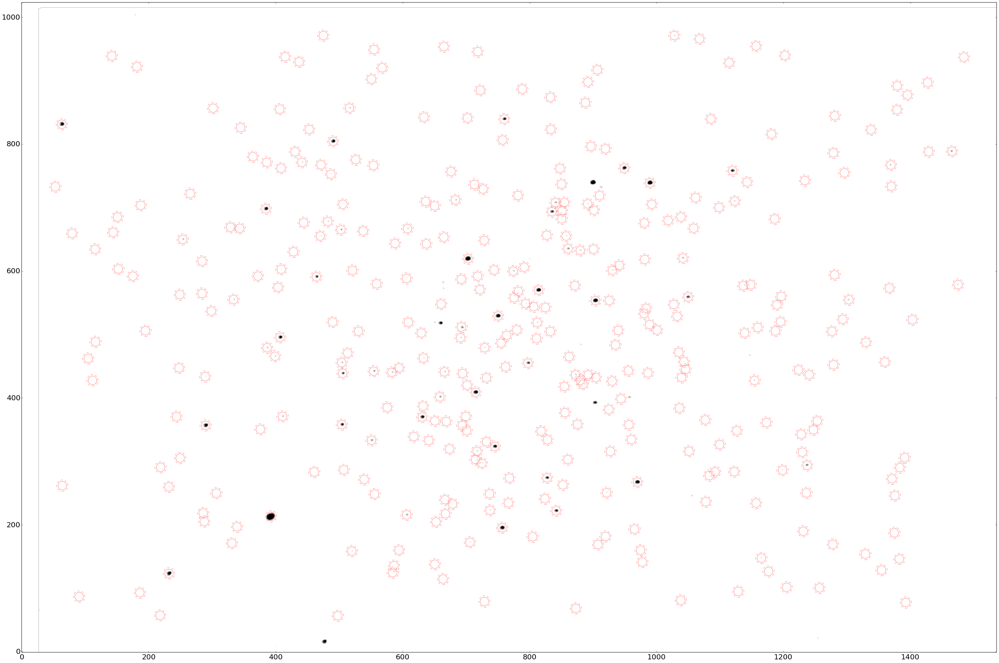

In [129]:
M67_HR.fluxArray()

Some stars are a little bit too close to their neighbors. Hence I will keep the radii for the annuli.

### HR diagram

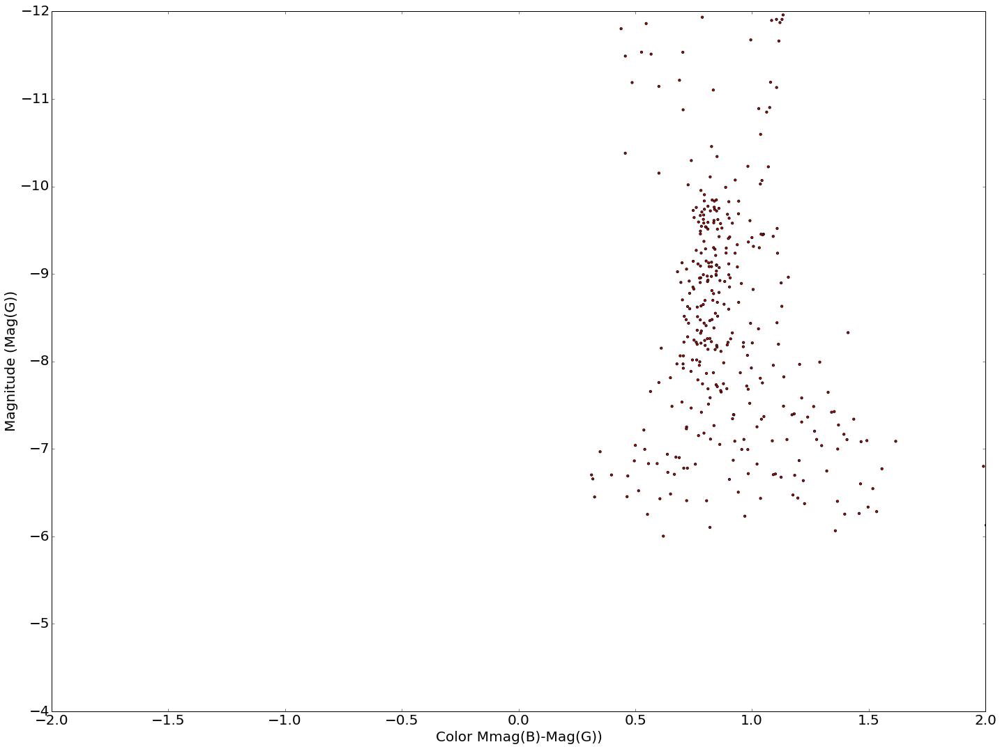

In [130]:
M67_HR.dispHR()

One would expect that M67, being an open cluster, should be (a lot) younger than M3, and therefore prosesseing more main sequence stars. However, given the uncertainty in magnitude, it is hard to tell where this "blob" sits in M3's diagram. Comparison can't be made until we've done calibrating the flux. Assume that the x-axis is accurate, then, this could be exactly where the "branching" occurs, and thus the weird shape